<a href="https://colab.research.google.com/github/Phan-Kandula/Mitosis_counting/blob/main/EC_ecs171.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**Name: Phanindra Kandula**

**SID: 915877823**

Downloading yolov5

In [ ]:
!git clone https://github.com/ultralytics/yolov5  # clone repo
!pip install -qr yolov5/requirements.txt  # install dependencies (ignore errors)
%cd yolov5

Cloning into 'yolov5'...
remote: Enumerating objects: 22, done.
remote: Counting objects: 100% (22/22), done.
remote: Compressing objects: 100% (14/14), done.
remote: Total 2535 (delta 10), reused 18 (delta 8), pack-reused 2513
Receiving objects: 100% (2535/2535), 5.39 MiB | 20.14 MiB/s, done.
Resolving deltas: 100% (1663/1663), done.
     |████████████████████████████████| 276kB 3.4MB/s 
/content/yolov5


In [ ]:
import torch
from IPython.display import Image, clear_output  # to display images
from utils.google_utils import gdrive_download  # to download models/datasets

clear_output()
print('Setup complete. Using torch %s %s' % (torch.__version__, torch.cuda.get_device_properties(0) if torch.cuda.is_available() else 'CPU'))

Setup complete. Using torch 1.6.0+cu101 _CudaDeviceProperties(name='Tesla T4', major=7, minor=5, total_memory=15079MB, multi_processor_count=40)


I uploaded all images in the train.txt to roboflow(since only 1000 images are free) and made two augmentations: flipping and  adding 5% noise. While flipping only makes more images to train on, adding noise should really help because these images are blurry. I forgot to make a validation set so everything is downloaded into the train set but I built another script below to move some of the files to validation set.

In [ ]:
%cd /content
!curl -L "https://app.roboflow.com/ds/DG4CvdP8Ly?key=#########" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip

Streaming output truncated to the last 5000 lines.
 extracting: train/images/70H05_03Cb_tiff_jpg.rf.9d76ada4162a50108c9705fa3d4c2ec3.jpg  
 extracting: train/images/04A07_01Da_tiff_jpg.rf.9cd512516a29ab22210ed75d0741a1a8.jpg  
 extracting: train/images/13H05_03Da_tiff_jpg.rf.9ccf4c0d090a6162091d8dab509da874.jpg  
 extracting: train/images/04H05_03Bc_tiff_jpg.rf.9d5a2a0f8db2e4d5f497fd7fddbf902f.jpg  
 extracting: train/images/42A04_06Ad_tiff_jpg.rf.9df1a06f7c39fd514f926e24899766db.jpg  
 extracting: train/images/66A04_05Aa_tiff_jpg.rf.9dcf5ce017e69c5aa853a7d165314626.jpg  
 extracting: train/images/03A04_02Ab_tiff_jpg.rf.9de12d54451c9090ee92ae1123645875.jpg  
 extracting: train/images/73A05_03Dd_tiff_jpg.rf.9df0cee1a69bbaef538b1c158d35d19e.jpg  
 extracting: train/images/07A04_00Ad_tiff_jpg.rf.9e24ce8eff2aeaca4c2112341a3653c3.jpg  
 extracting: train/images/70H10_04Da_tiff_jpg.rf.9e33ee423dd912d2844394d3ea344812.jpg  
 extracting: train/images/67H04_03Da_tiff_jpg.rf.9df9170b213c479de1a5

Getting number of classes from data.yaml

In [ ]:
%cat data.yaml

train: ../train/images
val: ../valid/images

nc: 1
names: ['mitosis']

In [ ]:
import yaml
with open("data.yaml", 'r') as stream:
    num_classes = str(yaml.safe_load(stream)['nc'])
    

Using yolov5m since it should be slightly better than yolov5s. It takes about 2 hours to train so I didn't want to expirement with the default anchors and stuff.

In [ ]:
%cat /content/yolov5/models/yolov5m.yaml

# parameters
nc: 80  # number of classes
depth_multiple: 0.67  # model depth multiple
width_multiple: 0.75  # layer channel multiple

# anchors
anchors:
  - [10,13, 16,30, 33,23]  # P3/8
  - [30,61, 62,45, 59,119]  # P4/16
  - [116,90, 156,198, 373,326]  # P5/32

# YOLOv5 backbone
backbone:
  # [from, number, module, args]
  [[-1, 1, Focus, [64, 3]],  # 0-P1/2
   [-1, 1, Conv, [128, 3, 2]],  # 1-P2/4
   [-1, 3, BottleneckCSP, [128]],
   [-1, 1, Conv, [256, 3, 2]],  # 3-P3/8
   [-1, 9, BottleneckCSP, [256]],
   [-1, 1, Conv, [512, 3, 2]],  # 5-P4/16
   [-1, 9, BottleneckCSP, [512]],
   [-1, 1, Conv, [1024, 3, 2]],  # 7-P5/32
   [-1, 1, SPP, [1024, [5, 9, 13]]],
   [-1, 3, BottleneckCSP, [1024, False]],  # 9
  ]

# YOLOv5 head
head:
  [[-1, 1, Conv, [512, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 6], 1, Concat, [1]],  # cat backbone P4
   [-1, 3, BottleneckCSP, [512, False]],  # 13

   [-1, 1, Conv, [256, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-

In [ ]:
from IPython.core.magic import register_line_cell_magic

@register_line_cell_magic
def writetemplate(line, cell):
    with open(line, 'w') as f:
        f.write(cell.format(**globals()))

In [ ]:
%%writetemplate /content/yolov5/models/custom_yolov5m.yaml

# parameters
nc: {num_classes}  # number of classes
depth_multiple: 0.67  # model depth multiple
width_multiple: 0.75  # layer channel multiple

# anchors
anchors:
  - [10,13, 16,30, 33,23]  # P3/8
  - [30,61, 62,45, 59,119]  # P4/16
  - [116,90, 156,198, 373,326]  # P5/32

# YOLOv5 backbone
backbone:
  # [from, number, module, args]
  [[-1, 1, Focus, [64, 3]],  # 0-P1/2
   [-1, 1, Conv, [128, 3, 2]],  # 1-P2/4
   [-1, 3, BottleneckCSP, [128]],
   [-1, 1, Conv, [256, 3, 2]],  # 3-P3/8
   [-1, 9, BottleneckCSP, [256]],
   [-1, 1, Conv, [512, 3, 2]],  # 5-P4/16
   [-1, 9, BottleneckCSP, [512]],
   [-1, 1, Conv, [1024, 3, 2]],  # 7-P5/32
   [-1, 1, SPP, [1024, [5, 9, 13]]],
   [-1, 3, BottleneckCSP, [1024, False]],  # 9
  ]

# YOLOv5 head
head:
  [[-1, 1, Conv, [512, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 6], 1, Concat, [1]],  # cat backbone P4
   [-1, 3, BottleneckCSP, [512, False]],  # 13

   [-1, 1, Conv, [256, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 4], 1, Concat, [1]],  # cat backbone P3
   [-1, 3, BottleneckCSP, [256, False]],  # 17 (P3/8-small)

   [-1, 1, Conv, [256, 3, 2]],
   [[-1, 14], 1, Concat, [1]],  # cat head P4
   [-1, 3, BottleneckCSP, [512, False]],  # 20 (P4/16-medium)

   [-1, 1, Conv, [512, 3, 2]],
   [[-1, 10], 1, Concat, [1]],  # cat head P5
   [-1, 3, BottleneckCSP, [1024, False]],  # 23 (P5/32-large)

   [[17, 20, 23], 1, Detect, [nc, anchors]],  # Detect(P3, P4, P5)
  ]

As said before, I am making the validation set. I am moving 20% of the images from train set to the validation set.

In [ ]:
%mkdir /content/valid
%mkdir /content/valid/images
%mkdir /content/valid/labels

In [ ]:
%cd /content/train/images
import glob
import shutil
image_names = (glob.glob("*")) #This is an array with all the names of the images. 
for i in range(int(len(image_names)*0.2)): #Using the first 20% of the images as the validation set
    name = image_names[i]
    label_name = name[0:-3] + "txt" # replacing the ".jpg" at the end of the image name with ".txt"
    shutil.move(name, "../../valid/images/"+name) #moving the image to valid/images/
    shutil.move("../labels/"+label_name, "../../valid/labels/"+label_name) #moving the yolov5 format labels to valid/labels/

**Training now**

Using 120 epochs of batch size 16. Using yolov5m for better predictions.

In [ ]:
# train yolov5m on custom data for 120 epochs
# time its performance
%%time
%cd /content/yolov5/
!python train.py --img 416 --batch 16 --epochs 120 --data '../data.yaml' --cfg ./models/custom_yolov5m.yaml --weights '' --name yolov5s_results  --cache

/content/yolov5
Using CUDA device0 _CudaDeviceProperties(name='Tesla T4', total_memory=15079MB)

Namespace(adam=False, batch_size=16, bucket='', cache_images=True, cfg='./models/custom_yolov5m.yaml', data='../data.yaml', device='', epochs=120, evolve=False, global_rank=-1, hyp='data/hyp.scratch.yaml', image_weights=False, img_size=[416, 416], local_rank=-1, logdir='runs/', multi_scale=False, name='yolov5s_results', noautoanchor=False, nosave=False, notest=False, rect=False, resume=False, single_cls=False, sync_bn=False, total_batch_size=16, weights='', workers=8, world_size=1)
Start Tensorboard with "tensorboard --logdir runs/", view at http://localhost:6006/
2020-09-14 22:19:00.531180: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library libcudart.so.10.1
Hyperparameters {'lr0': 0.01, 'lrf': 0.2, 'momentum': 0.937, 'weight_decay': 0.0005, 'warmup_epochs': 3.0, 'warmup_momentum': 0.8, 'warmup_bias_lr': 0.1, 'giou': 0.05, 'cls': 0.5, 'cls_p

In [ ]:
%load_ext tensorboard
%tensorboard --logdir runs

<IPython.core.display.Javascript object>

Storing the weights in my personal google drive for later.

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [ ]:
%cp /content/yolov5/runs/exp0_yolov5s_results/weights/best.pt /content/gdrive/My\ Drive

In [ ]:
%cp /content/yolov5/runs/exp0_yolov5s_results/weights/last.pt /content/gdrive/My\ Drive

In [ ]:
%cp /content/gdrive/My\ Drive/best.pt /content/yolov5/weights/

I made another account in roboflow to annotate the test set since only 1000 images are free. This is the training set. 

In [ ]:
%cd /content
!curl -L "https://app.roboflow.com/ds/MNErZGybO7?key=#########" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip


/content
  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100   896  100   896    0     0    858      0  0:00:01  0:00:01 --:--:--   858
100 3645k  100 3645k    0     0  2916k      0  0:00:01  0:00:01 --:--:-- 2916k
Archive:  roboflow.zip
 extracting: test/images/04A03_04Ad_tiff_jpg.rf.0533830cf571b748f167fc1eac2b15ff.jpg  
 extracting: test/images/15A03_02Bc_tiff_jpg.rf.04f1db3509c9628070962b6faa752707.jpg  
 extracting: test/images/31A03_00Ba_tiff_jpg.rf.0aa69a5b06ec000502586a86c484e34e.jpg  
 extracting: test/images/34A03_03Ac_tiff_jpg.rf.0876707a636228d82cd354fff9b29219.jpg  
 extracting: test/images/63A03_00Cc_tiff_jpg.rf.174451278920904ab7f2615de9d84be0.jpg  
 extracting: test/images/22A03_02Da_tiff_jpg.rf.079a7c8c005e9a4e31b1a59be5989db9.jpg  
 extracting: test/images/27A03_04Cd_tiff_jpg.rf.1490009a6ba757eb095c3ae0e03cc696.jpg  
 extracting: test/images/62A03_03Ad_tiff_jp

The data.yaml doesn't include the test set, so I manually added it in.

In [ ]:
cat data.yaml

train: ../train/images
val: ../valid/images

nc: 1
names: ['mitosis']
test: ../test/images


In [ ]:
%cd /content/
import yaml
import os
f = open("data.yaml", "a")
f.write(os.linesep + "test: ../test/images" + os.linesep)
f.close()

/content


Using detect.py on the test set to visualize it. Looks good!

In [ ]:
%cd /content/yolov5/
!python detect.py --weights /content/yolov5/weights/best.pt --img 416 --conf 0.5 --source ../test/images

/content/yolov5
Namespace(agnostic_nms=False, augment=False, classes=None, conf_thres=0.5, device='', img_size=416, iou_thres=0.5, output='inference/output', save_txt=False, source='../test/images', update=False, view_img=False, weights=['/content/yolov5/weights/best.pt'])
Using CUDA device0 _CudaDeviceProperties(name='Tesla T4', total_memory=15079MB)

Fusing layers... 
Model Summary: 188 layers, 2.14686e+07 parameters, 2.00672e+07 gradients
image 1/132 /content/test/images/00A03_03Ca_tiff_jpg.rf.6e19ea79aa2d805a3db4ab972b06ef9c.jpg: 416x416 Done. (0.015s)
image 2/132 /content/test/images/00A03_05Cd_tiff_jpg.rf.3beb6fdcd4ee7592b7653cb53ed1b62e.jpg: 416x416 1 mitosiss, Done. (0.016s)
image 3/132 /content/test/images/02A03_05Bb_tiff_jpg.rf.561f6b47bafb267761392d02d1ceedb3.jpg: 416x416 1 mitosiss, Done. (0.016s)
image 4/132 /content/test/images/03A03_02Dd_tiff_jpg.rf.bf07a0bc5f25aa6f0dab242a0627fa74.jpg: 416x416 1 mitosiss, Done. (0.017s)
image 5/132 /content/test/images/04A03_01Ba_tiff_j

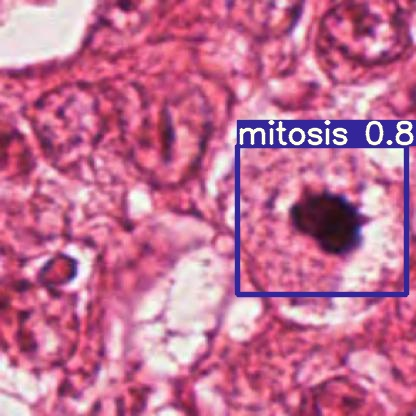

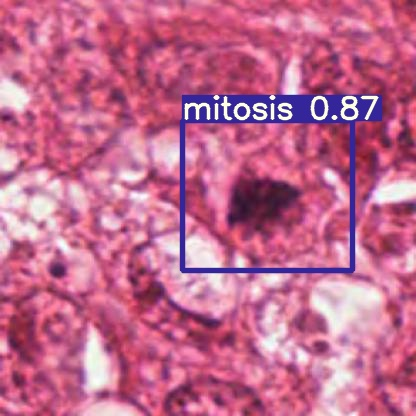

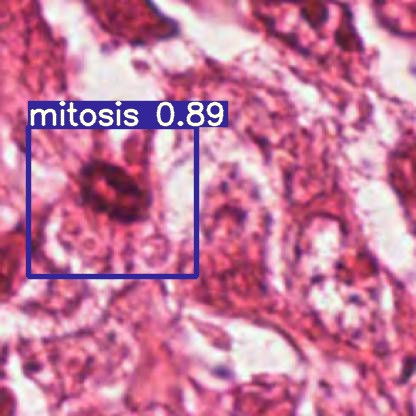

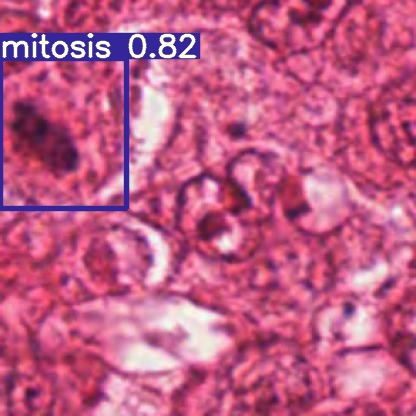

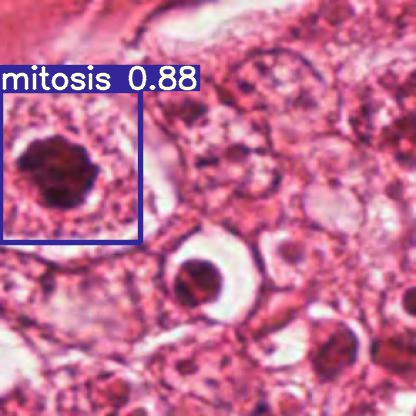

...

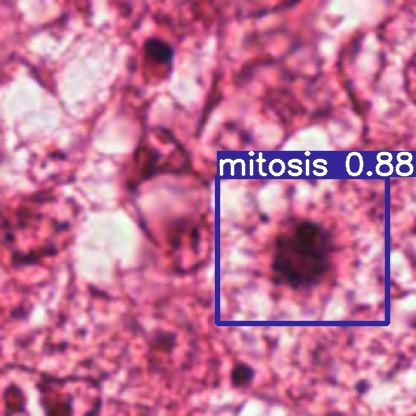

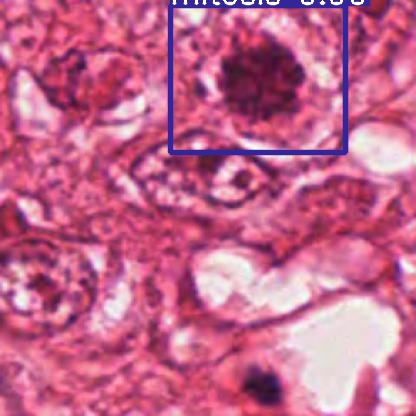

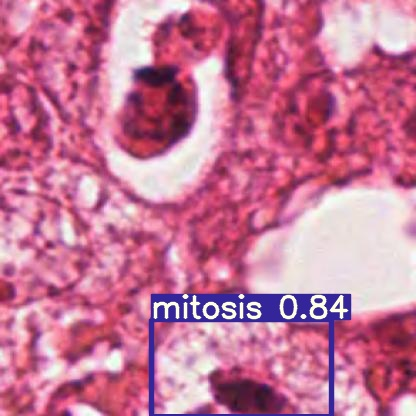

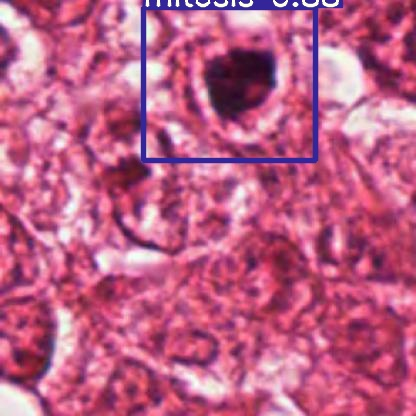

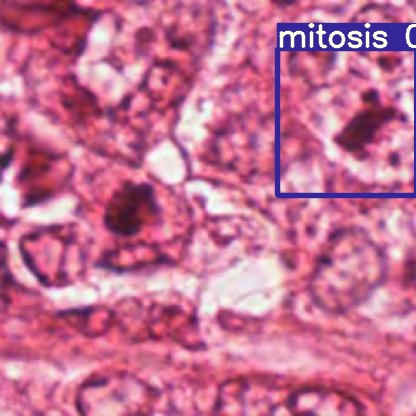

In [ ]:
import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/yolov5/inference/output/*.jpg'): #assuming JPG
    display(Image(filename=imageName))

    print("\n")

Now using test.py to get the predictions to compare with ground truth values.

In [ ]:
%cd /content/yolov5/
!python test.py --weights /content/yolov5/weights/best.pt --data ../data.yaml --img 416 --conf 0.5 --task test --save-txt


/content/yolov5
Namespace(augment=False, batch_size=32, conf_thres=0.5, data='../data.yaml', device='', img_size=416, iou_thres=0.65, merge=False, save_json=False, save_txt=True, single_cls=False, task='test', verbose=False, weights=['/content/yolov5/weights/best.pt'])
Using CUDA device0 _CudaDeviceProperties(name='Tesla T4', total_memory=15079MB)

Fusing layers... 
Model Summary: 188 layers, 2.14686e+07 parameters, 2.00672e+07 gradients
Scanning labels ../test/labels.cache (132 found, 0 missing, 0 empty, 0 duplicate, for 132 images): 132it [00:00, 17848.10it/s]
               Class      Images     Targets           P           R      mAP@.5  mAP@.5:.95: 100% 5/5 [00:01<00:00,  3.16it/s]
                 all         132         135       0.959       0.859       0.845       0.423
Speed: 4.0/1.2/5.2 ms inference/NMS/total per 416x416 image at batch-size 32


Moving it to google drive to keep it safe.

In [ ]:
%cp -r /content/yolov5/inference/output/ /content/gdrive/My\ Drive/ai_output_ecs171/

In [ ]:
%cp -r /content/gdrive/My\ Drive/ai_output_ecs171/ /content/yolov5/inference/output/

These are predictions still in the yolov5 format.

In [ ]:
%cd /content/gdrive/My\ Drive/ai_output_ecs171/
%ls

/content/gdrive/My Drive/ai_output_ecs171
00A03_03Ca_tiff_jpg.rf.6e19ea79aa2d805a3db4ab972b06ef9c.txt
00A03_05Cd_tiff_jpg.rf.3beb6fdcd4ee7592b7653cb53ed1b62e.txt
02A03_05Bb_tiff_jpg.rf.561f6b47bafb267761392d02d1ceedb3.txt
04A03_04Ad_tiff_jpg.rf.0533830cf571b748f167fc1eac2b15ff.txt
04A03_05Ba_tiff_jpg.rf.bd8ae8302bcf4692219fad117cba7e68.txt
05A03_00Bb_tiff_jpg.rf.ea7f04eb55e267e38ae734c988dc3d2f.txt
05A03_03Cd_tiff_jpg.rf.4bb36c8239c5b06fbda9549feb70e6d3.txt
05A03_04Bc_tiff_jpg.rf.390c58805b0b1ba3cbc56d836340b30f.txt
05A03_04Da_tiff_jpg.rf.a606ab54c68d664df30451a73133a2ed.txt
06A03_04Ac_tiff_jpg.rf.c25ef6432654d7428e18f7935e240d1d.txt
06A03_04Da_tiff_jpg.rf.2d11f57b27f30bba08445582a093689d.txt
07A03_04Da_tiff_jpg.rf.baa8a828c979c914da1cf259cc365124.txt
07A03_05Db_tiff_jpg.rf.e837ca71ae3765967a17acf204f3b306.txt
11A03_03Ab_tiff_jpg.rf.8e3a7c425990314a2a6bda2685b29079.txt
11A03_05Ca_tiff_jpg.rf.40fe404536434fb796b9a03e882830b1.txt
13A03_00Ca_tiff_jpg.rf.a4d2f3137acda3011022b1b7b25a0fff.tx

**Calculating F-score**

Since the images were resized and the annotation format was changed, calculating Fscore is complex.

The resolution of the images are 0.2455 µm per pixel. The website said the center of the mitosis cells can be within 8µm. So the center must be within  $\frac{8}{0.2455}$ = 32.596 pixels. When the images are scaled to the yoloV5 size of 416x416 pixel size, the acceptable error range also scales by the same amount or the ratio. Since yoloV5 is annotated using perccentages, calculating the error% in the original images would be easier


---



The H images had the dimension of 314x352 pixels.  

* H-images X-axis error range: $\frac{32.596}{314}$ = 0.103

* H-images Y-axis error range: $\frac{32.596}{253}$ = 0.092


---


The A images had the dimension of 292x326 pixels.  

* A-images X-axis error range: $\frac{32.596}{292}$ = 0.111

* A-images Y-axis error range: $\frac{32.596}{326}$ = 0.099



---



  

F-score is given by 2 * (Precision * Recall ) / (Rrecision + Recall).

Precision = TP / (TP+FP)

Recall = TP / (TP+FN)


In [ ]:
%cd /content/

/content


In [ ]:
import glob

xh = 0.103 #acceptable error percentage for H-images X-axis
yh = 0.092 #acceptable error percentage for H-images Y-axis
xa = 0.111 #acceptable error percentage for A-images X-axis
ya = 0.099 #acceptable error percentage for A-images Y-axis

folder1 = "test/labels/" #test values
folder2 = "yolov5/inference/output/" #predicted values

d  = 0    # Number of predictions
tp = 0    # True positives. Correct predictions
fp = 0    # False positives. Wrong predictions
fn = 0    # False negatives. Didn't predict a mitosis cell

label_names = glob.glob(folder1+"*") #A list of all test_labels.txt

for label in label_names:
    label = label[12:] #The first 12 letters are its path
    xdif = 0           # xdif and ydif are going to be set to maximum error percentage depending on the image type 
    ydif = 0
    if label[2] == 'A':
        xdif = xa
        ydif = ya
    else:
        xdif = xh
        ydif = yh

    pred_centers = []
    true_centers = []

    # Reads the test label file for all true centers and adds it as a tuple to the true_centers array
    with open(folder1+label, "r") as f1: 
        for line in f1.readlines():
            words = line.split()
            true_centers.append((words[1],words[2]))

    # The ai doesn't create a file with centers if it fails to predict any centers in it. This is a false negative. 
    # So, if an error is thrown since there is no file, I add +1 to the fn counter. 
    # Reads the predicted_value file for all predicted centers and adds it as a tuple to the pred_centers array
    try:
        with open(folder2+label, "r") as f2:
          for line in f2.readlines():
              words = line.split()
              pred_centers.append((words[1],words[2]))
              #assuming this is the predictions
              d += 1
    except FileNotFoundError:
        #print (f'{label} not found') # this means that the ai failed to predict any mitosis cells in the image despite there being some. False negative.
        fn += 1
        continue

    # This iterates through the predictions and checks if any of them are within the acceptable error bounds of the true center. 
    # Since it is possible there could be many predictions and true values, it goes through all combinations.
    # If none of the true values match the predictions, fp is incremented.
    for i in pred_centers: # prediction
        temp_wrong = True
        for j in true_centers: # real values
            if abs(float(i[0])-float(j[0])) <=xdif and abs(float(i[1])-float(j[1])) <= ydif:
                tp += 1
                temp_wrong = False
                continue
        if temp_wrong:
            fp += 1

    # This is similar to previous double for loop. It checks if there are any true values that haven't been predicted. If yes, false negative is incremented. 
    for j in true_centers: # real values
        temp_wrong = True
        for i in pred_centers: # prediction
            if abs(float(i[0])-float(j[0])) <= xdif and abs(float(i[1])-float(j[1])) <= ydif:
                temp_wrong = False
                continue
        if temp_wrong:
            #print(f'{label} has false negatives {i} {j}')
            fn += 1

#calculating fscore using recall and precision.
recall = tp/(tp+fn)
precision = tp/(tp+fp)
fscore = 2 * (recall * precision) / (recall + precision)
print(f'F-score= {fscore}')

F-score= 0.921875
